In [ ]:
!nvidia-smi

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
HOME = os.getcwd()

HOME="/content"


In [ ]:

!pip install ultralytics==8.0.28

from IPython import display
display.clear_output()

import ultralytics
ultralytics.checks()

In [ ]:

from ultralytics import YOLO

from IPython.display import display, Image

## Importing Dataset from ROBOFLOW


In [ ]:
!mkdir {HOME}/datasets
%cd {HOME}/datasets

!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="nFfIEBI0ZbgVas8BHUBt")
project = rf.workspace("indian-institute-of-technology-jodhpour").project("cable-detection-liolt")
dataset = project.version(2).download("yolov8")





/content/datasets
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.3/63.3 kB 1.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.7/178.7 kB 7.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 6.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.1/49.1 MB 17.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.8/67.8 kB 8.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 72.2/72.2 kB 9.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 7.6 MB/s eta 0:00:00
  Attempting uninstall: pyparsing
    Found existing installation: pyparsing 3.1.1
    Uninstalling pyparsing-3.1.1:
      Successfully uninstalled pyparsing-3.1.1
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.8.1.78
    Uninstalling opencv-python-headless-4.8.1.78:
      Successfully uninstalled opencv-python-headless-4.8.1.78
  Attempting uninstall: idna
 

loading Roboflow workspace...
loading Roboflow project...
Dependency ultralytics==8.0.196 is required but found version=8.0.28, to fix: `pip install ultralytics==8.0.196`


In [ ]:
import shutil

In [ ]:
# #for deleting directory
# shutil.rmtree('/content/runs/')

## Custom Training

In [ ]:
%cd {HOME}

!yolo task=segment mode=train model=yolov8m-seg.pt data={dataset.location}/data.yaml epochs=43 imgsz=1280 batch=4

/content
100% 52.4M/52.4M [00:00<00:00, 235MB/s]
Ultralytics YOLOv8.0.28 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla T4, 15102MiB)
yolo/engine/trainer: task=segment, mode=train, model=yolov8m-seg.pt, data=/content/datasets/Cable-detection-2/data.yaml, epochs=43, patience=50, batch=4, imgsz=1280, save=True, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=False, optimizer=SGD, verbose=True, seed=0, deterministic=True, single_cls=False, image_weights=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, hide_labels=False, hide_conf=False, vid_stride=1, line_thickness=3, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, boxes=True, format=torchscript, keras=False, opti

In [ ]:
!ls {HOME}/runs/segment/train/

In [ ]:
import glob
from IPython.display import Image, display

for image_path in glob.glob(f'{HOME}/runs/segment/train/*.png'):
      display(Image(filename=image_path, height=1280))
      print("\n")

In [ ]:
%cd {HOME}
Image(filename=f'{HOME}/runs/segment/train/confusion_matrix.png', width=640)

In [ ]:
%cd {HOME}
Image(filename=f'{HOME}/runs/segment/train/results.png', width=640)

In [ ]:
%cd {HOME}
Image(filename=f'{HOME}/runs/segment/train/val_batch0_pred.jpg', width=640)

## Validate Custom Model / Predict


In [ ]:
%cd {HOME}

!yolo task=segment mode=val model={HOME}/runs/segment/train/weights/best.pt data={dataset.location}/data.yaml

## Inference with Custom Model

In [ ]:
%cd {HOME}
!yolo task=segment mode=predict model={HOME}/runs/segment/train/weights/best.pt conf=0.25 source={dataset.location}/test/images save=true

/content
2023-10-07 04:23:49.051192: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-10-07 04:23:49.911213: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
Ultralytics YOLOv8.0.28 🚀 Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)
YOLOv8m-seg summary (fused): 245 layers, 27224700 parameters, 0 gradients, 110.0 GFLOPs

image 1/236 /content/datasets/Cable-detection-1/test/images/09_2550_jpg.rf.3dbbcad80339daf72d17c4398436d44e.jpg: 640x640 12 cables, 1 tower_wooden, 46.1ms
image 2/236 /content/datasets/Cable-detection-1/test/images/103_5565_jpg.rf.1a99f775f801ed9890cdbdf5e095cd9d.jpg: 640x640 9 cables, 1 tower_lattice, 45.8ms
image 3/236 /content/datasets/Cable-detection-1/test/images/105_2265

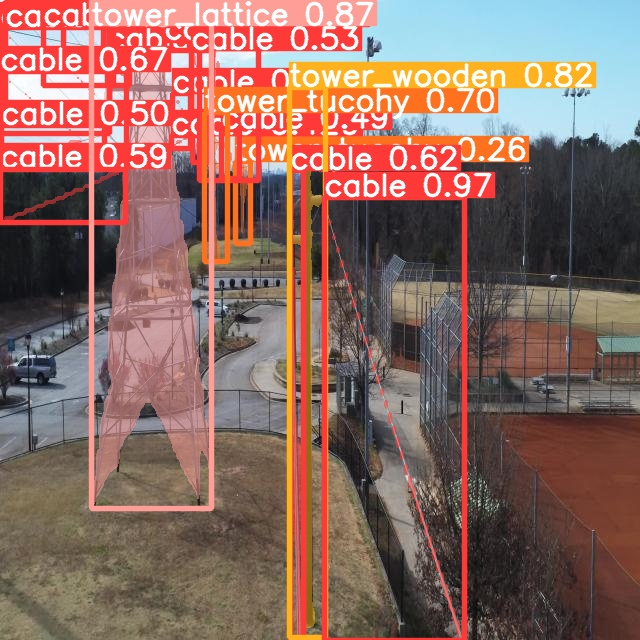

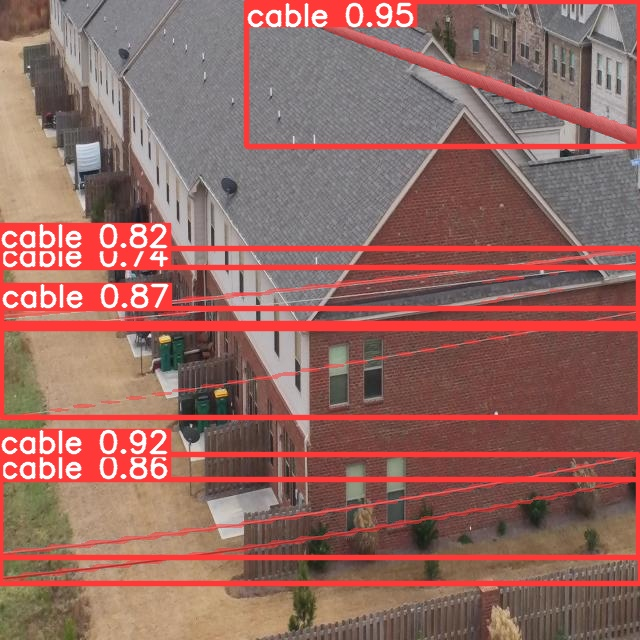

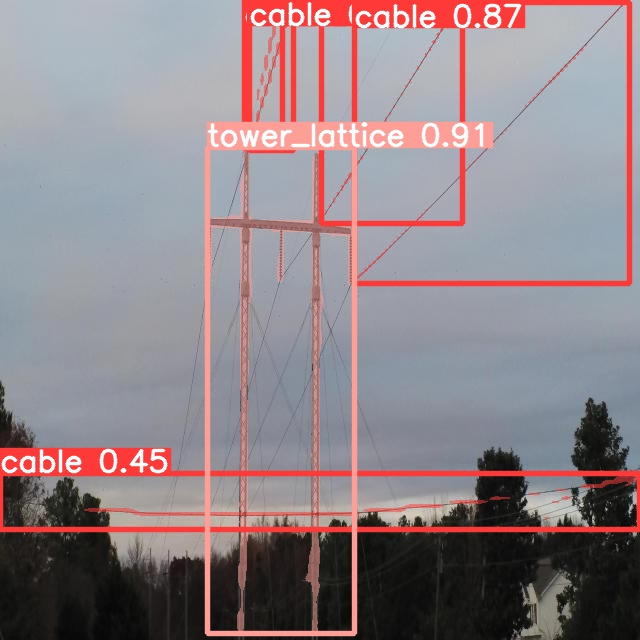

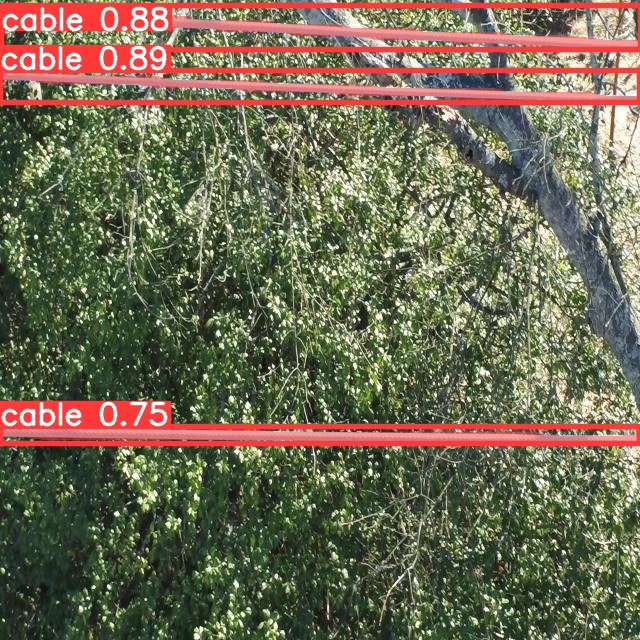

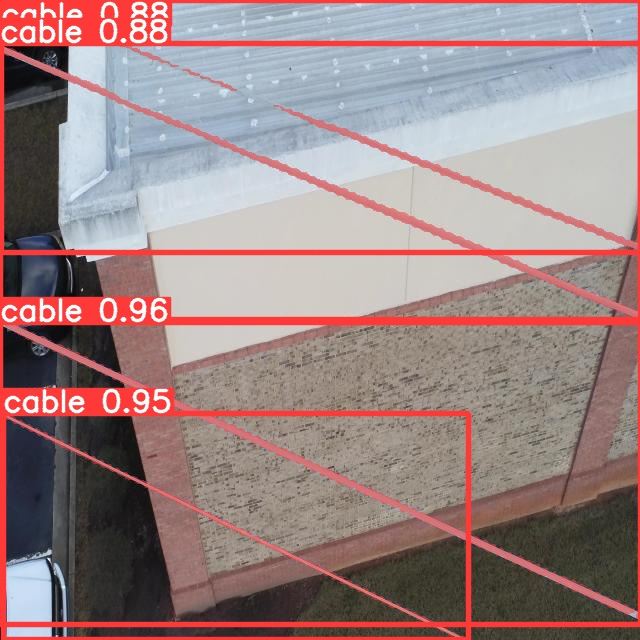

...

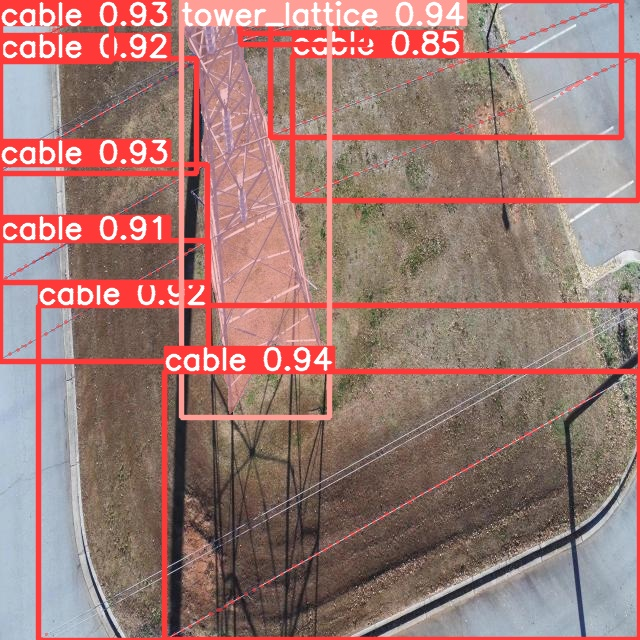

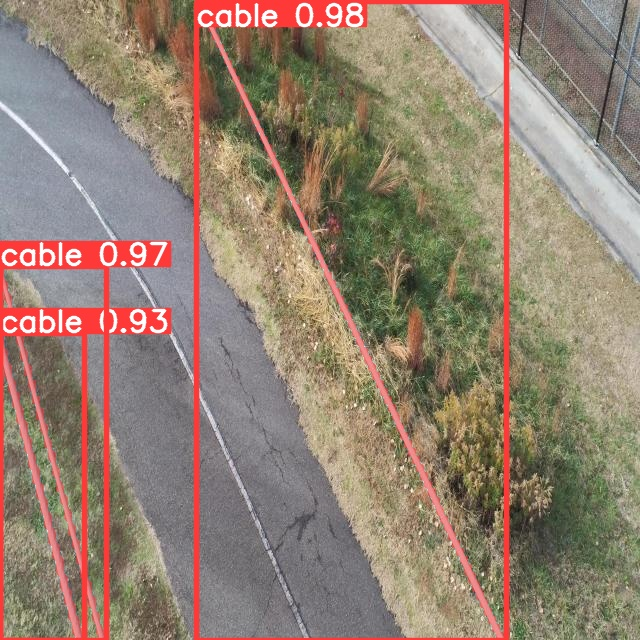

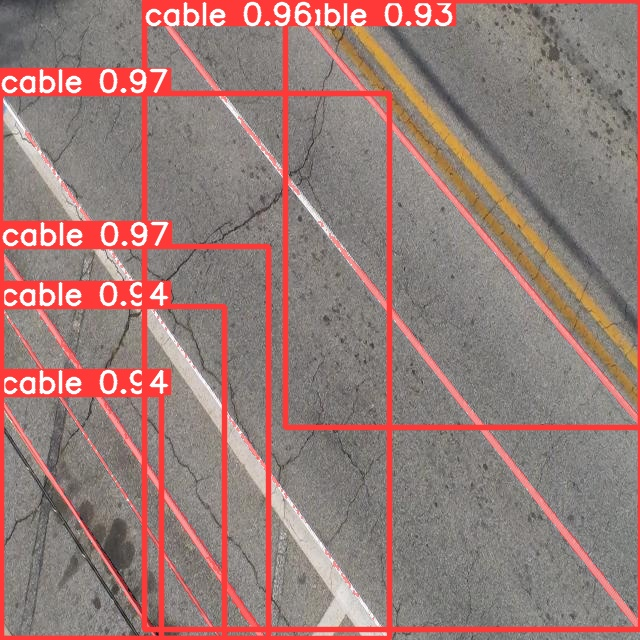

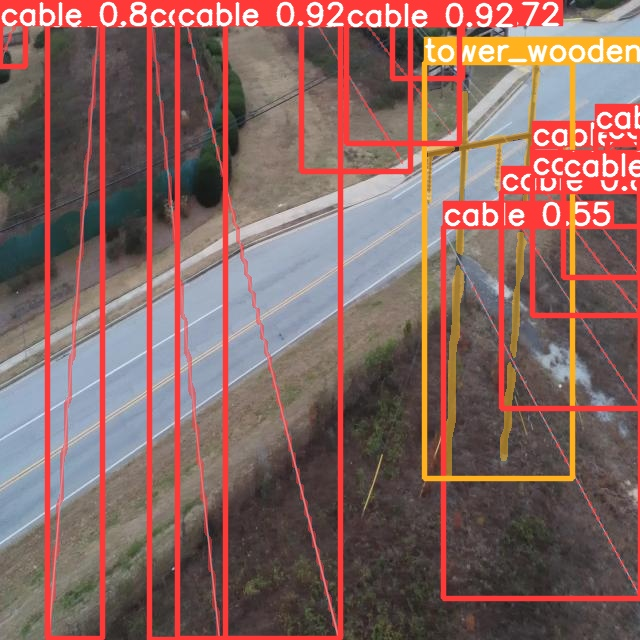

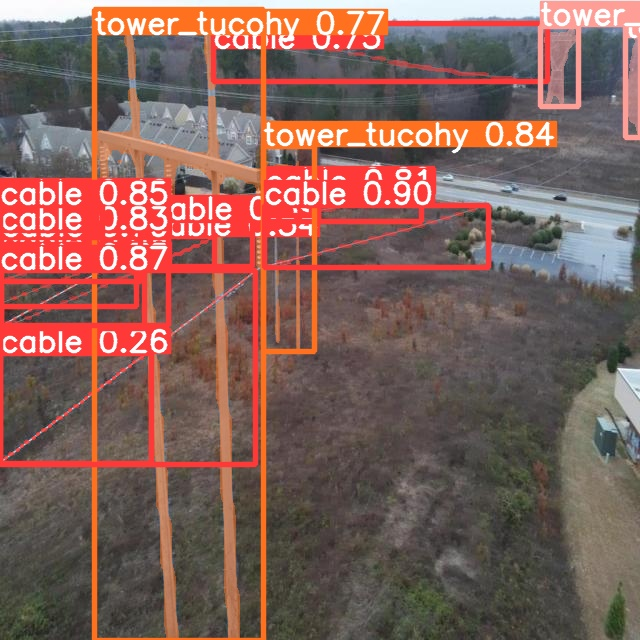

In [ ]:

for image_path in glob.glob(f'{HOME}/runs/segment/predict/*.jpg')[:200]:
      display(Image(filename=image_path, height=600))
      print("\n")

In [ ]:
!python export.py --weights runs/train/Model/weights/best.pt --include torchscript onnx

python3: can't open file '/content/export.py': [Errno 2] No such file or directory


In [ ]:
%cd {HOME}
!yolo task=segment mode=val model={HOME}/runs/segment/train/weights/best.pt data={dataset.location}/data.yaml

In [ ]:
# directory_name = "640images_input"

# # Create the directory
# os.makedirs(directory_name)
# directory_name = "custom_input"

# # Create the directory
# os.makedirs(directory_name)

# # Check the contents of the current directory
# print(os.listdir())


In [ ]:
# import os
# import cv2

# input_folder = '/content/custom_input'
# output_folder = '/content/640images_input'

# if not os.path.exists(output_folder):
#     os.makedirs(output_folder)

# # Desired size
# desired_size = (640, 640)

# # Loop through all files in the input folder
# for filename in os.listdir(input_folder):
#     if filename.endswith(('.jpg', '.jpeg', '.png', '.bmp', '.gif')):
#         # Load the image
#         input_path = os.path.join(input_folder, filename)
#         image = cv2.imread(input_path)

#         # Resize the image
#         resized_image = cv2.resize(image, desired_size)

#         # Save the resized image to the output folder
#         output_path = os.path.join(output_folder, filename)
#         cv2.imwrite(output_path, resized_image)

# print("All images resized and saved to the output folder.")


In [ ]:
# import os

# # Define paths
# model_weights = f"/content/yolov8m-seg.pt"
# custom_image_path = "image.jpg"
# confidence_threshold = 0.25

# # Build the inference command
# inference_command = (
#     f"!yolo task=segment mode=predict model={model_weights} "
#     f"conf={confidence_threshold} source={custom_image_path} save=true"
# )

# # Execute the inference command
# os.system(inference_command)

In [ ]:
# # Define paths
# model_weights = "/content/drive/MyDrive/btp/yolov8m-seg.pt"
# custom_image_path = "/content/drive/MyDrive/btp/Safeimagekit-resized-img.png"
# confidence_threshold = 0.25

# # Build the inference command with the correct syntax
# inference_command = (
#     f"yolo task=segment mode=predict model={model_weights} "
#     f"conf={confidence_threshold} source={custom_image_path} save=true"
# )

# # Execute the inference command using !
# !{inference_command}
